In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"ymohsenzadeh","key":"ec974bfdcfe13d39410e17438dc1d36c"}'}

In [ ]:
!mkdir -p ~/.kaggle
!mv kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
import kagglehub

path = kagglehub.dataset_download("mojtabafarahani/asphalt-segmentation-dataset")

print("Path to dataset files:", path)

100%|██████████| 2.88G/2.88G [00:38<00:00, 79.8MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/mojtabafarahani/asphalt-segmentation-dataset/versions/1


In [ ]:
import os
import cv2
from pycocotools.coco import COCO
import numpy as np
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import random
from sklearn.model_selection import train_test_split

In [ ]:
!ls -R /root/.cache/kagglehub/datasets/mojtabafarahani/asphalt-segmentation-dataset/versions/1

/root/.cache/kagglehub/datasets/mojtabafarahani/asphalt-segmentation-dataset/versions/1:
README.dataset.txt  README.roboflow.txt  test  train  valid

/root/.cache/kagglehub/datasets/mojtabafarahani/asphalt-segmentation-dataset/versions/1/test:
11_jpg.rf.c3d2d08ac2e0b4ea092f10ec532810bd.jpg
1-3-_jpg.rf.18db3719fd9b900ac8d364ffc8a9e124.jpg
1-4-_jpg.rf.78a34d7a312fe9c5b0ae06c127839752.jpg
14_jpg.rf.d9d2bc1c3cb17ed2b0c543c20be55a91.jpg
16_jpg.rf.67b9e10c2e7ec56d2c45acf77d0d272a.jpg
1-7-_jpg.rf.610e807363a88f7a04ab75ad4fe7d696.jpg
18_jpg.rf.2c4ec670f817336c71db47ab7c2cb3ea.jpg
1_jpg.rf.1dbf4f0a6ef805aeeea4af6aa2a0e8ce.jpg
20_jpg.rf.912cf9859700bbb46127fa468a74a670.jpg
21_jpg.rf.f3086f9405739e959d30711ea8922cb6.jpg
26_jpg.rf.8cf391405f59645cc184a81e5a7ebbf8.jpg
27_jpg.rf.a71c58ddc706f2fccc14dfae11a44437.jpg
40_jpg.rf.08453af28511256320c44fcb32990a87.jpg
50_jpg.rf.13ff05da4d211b86f962c53566013056.jpg
5_jpg.rf.0ae19bbf48b4725f7ec61a3d46eeba9c.jpg
_annotations.coco.json
-_-_jpg.rf.05ed0d1c0f920

**2.3. Dataset Preparation for Training**




In [ ]:
items = []

for split in ["train", "valid", "test"]:
    img_dir = os.path.join(path, split)
    ann_file = os.path.join(img_dir, "_annotations.coco.json")
    coco = COCO(ann_file)
    for img_id in coco.imgs:
        info = coco.loadImgs(img_id)[0]
        items.append((img_dir, info['file_name'], ann_file, img_id))


loading annotations into memory...
Done (t=0.11s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


In [ ]:
cracked = []
undamaged = []

for item in items:
    img_dir, file_name, ann_file, img_id = item
    coco = COCO(ann_file)
    ann_ids = coco.getAnnIds(imgIds=img_id)
    if len(ann_ids) > 0:
        cracked.append(item)
    else:
        undamaged.append(item)

all_items = cracked + undamaged
labels = [1] * len(cracked) + [0] * len(undamaged)

random_seed = 42

train_items, temp_items, train_labels, temp_labels = train_test_split(
    all_items, labels, test_size=0.3, stratify=labels, random_state=random_seed
)

val_items, test_items, val_labels, test_labels = train_test_split(
    temp_items, temp_labels, test_size=0.5, stratify=temp_labels, random_state=random_seed
)

random.shuffle(train_items)
random.shuffle(val_items)
random.shuffle(test_items)

print("Training set:", train_labels.count(1), "cracked,", train_labels.count(0), "undamaged")
print("Validation set:", val_labels.count(1), "cracked,", val_labels.count(0), "undamaged")
print("Test set:", test_labels.count(1), "cracked,", test_labels.count(0), "undamaged")


Streaming output truncated to the last 5000 lines.
index created!
loading annotations into memory...
Done (t=0.11s)
creating index...
index created!
loading annotations into memory...
Done (t=0.12s)
creating index...
index created!
loading annotations into memory...
Done (t=0.11s)
creating index...
index created!
loading annotations into memory...
Done (t=0.11s)
creating index...
index created!
loading annotations into memory...
Done (t=0.11s)
creating index...
index created!
loading annotations into memory...
Done (t=0.11s)
creating index...
index created!
loading annotations into memory...
Done (t=0.11s)
creating index...
index created!
loading annotations into memory...
Done (t=0.11s)
creating index...
index created!
loading annotations into memory...
Done (t=0.12s)
creating index...
index created!
loading annotations into memory...
Done (t=0.13s)
creating index...
index created!
loading annotations into memory...
Done (t=0.11s)
creating index...
index created!
loading annotations i

**2.2.  Data Preprocessing**

In [ ]:
class preprocessing_dataset(Dataset):
    def __init__(self, items, img_size=(512, 512)):
        self.items = items
        self.img_size = img_size
        self.coco_cache = {}

        for _, _, ann_file, _ in items:
            if ann_file not in self.coco_cache:
                self.coco_cache[ann_file] = COCO(ann_file)

    def __len__(self):
        return len(self.items)

    def __getitem__(self, idx):
        img_dir, file_name, ann_file, img_id = self.items[idx]
        coco = self.coco_cache[ann_file]

        img_path = os.path.join(img_dir, file_name)
        image = cv2.imread(img_path)
        if image is None:
            raise FileNotFoundError(f"Image not found: {img_path}")
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        h, w = self.img_size
        image = cv2.resize(image, (w, h), interpolation=cv2.INTER_LINEAR)
        image = image.astype(np.float32) / 255.0

        image = np.transpose(image, (2, 0, 1))

        ann_ids = coco.getAnnIds(imgIds=img_id)
        anns = coco.loadAnns(ann_ids)

        mask = np.zeros((coco.imgs[img_id]['height'], coco.imgs[img_id]['width']), dtype=np.uint8)
        for ann in anns:
            mask = np.maximum(mask, (coco.annToMask(ann) > 0).astype(np.uint8))

        mask = cv2.resize(mask, (w, h), interpolation=cv2.INTER_NEAREST)
        mask = np.expand_dims(mask, axis=0).astype(np.float32)

        return torch.from_numpy(image), torch.from_numpy(mask)


In [ ]:
train_dataset = preprocessing_dataset(train_items)
val_dataset = preprocessing_dataset(val_items)
test_dataset = preprocessing_dataset(test_items)

train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=4, shuffle=False)

loading annotations into memory...
Done (t=0.11s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.13s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.11s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


In [ ]:
print("Dataset sizes:")
print(f"Train: {len(train_dataset)} images")
print(f"Validation: {len(val_dataset)} images")
print(f"Test: {len(test_dataset)} images")

Dataset sizes:
Train: 1479 images
Validation: 317 images
Test: 317 images


**2.4. Final Checks**

In [ ]:
for images, masks in train_loader:
    print(images.shape)
    print(masks.shape)
    break
for images, masks in val_loader:
    print(images.shape)
    print(masks.shape)
    break
for images, masks in test_loader:
    print(images.shape)
    print(masks.shape)
    break

torch.Size([4, 3, 512, 512])
torch.Size([4, 1, 512, 512])
torch.Size([4, 3, 512, 512])
torch.Size([4, 1, 512, 512])
torch.Size([4, 3, 512, 512])
torch.Size([4, 1, 512, 512])


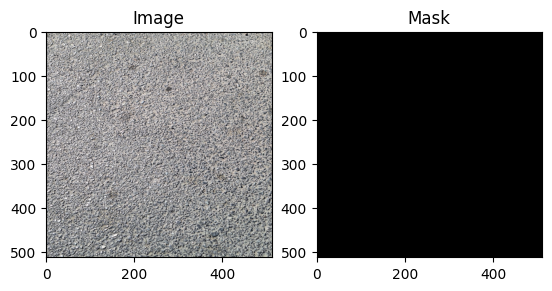

In [ ]:
img, mask = train_dataset[10]

import matplotlib.pyplot as plt
import numpy as np

plt.subplot(1,2,1)
plt.imshow(np.transpose(img.numpy(), (1,2,0)))
plt.title("Image")

plt.subplot(1,2,2)
plt.imshow(mask.numpy().squeeze(), cmap="gray")
plt.title("Mask")
plt.show()


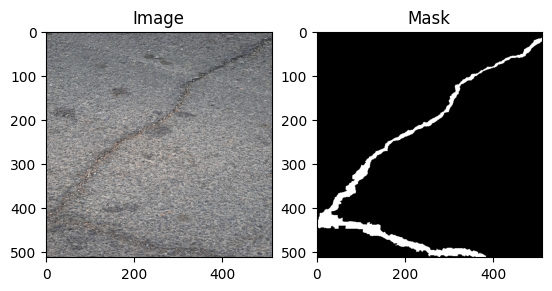

In [ ]:
img, mask = train_dataset[100]

import matplotlib.pyplot as plt
import numpy as np

plt.subplot(1,2,1)
plt.imshow(np.transpose(img.numpy(), (1,2,0)))
plt.title("Image")

plt.subplot(1,2,2)
plt.imshow(mask.numpy().squeeze(), cmap="gray")
plt.title("Mask")
plt.show()


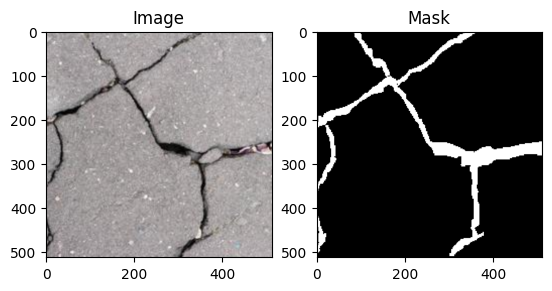

In [ ]:
img, mask = test_dataset[1]

import matplotlib.pyplot as plt
import numpy as np

plt.subplot(1,2,1)
plt.imshow(np.transpose(img.numpy(), (1,2,0)))
plt.title("Image")

plt.subplot(1,2,2)
plt.imshow(mask.numpy().squeeze(), cmap="gray")
plt.title("Mask")
plt.show()


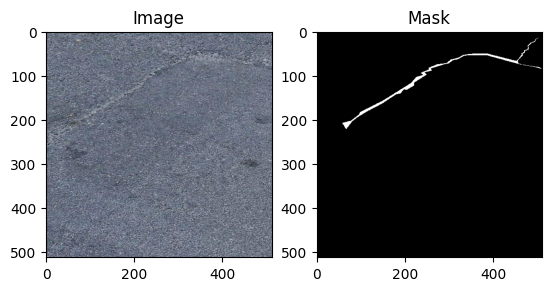

In [ ]:
img, mask = val_dataset[2]

import matplotlib.pyplot as plt
import numpy as np

plt.subplot(1,2,1)
plt.imshow(np.transpose(img.numpy(), (1,2,0)))
plt.title("Image")

plt.subplot(1,2,2)
plt.imshow(mask.numpy().squeeze(), cmap="gray")
plt.title("Mask")
plt.show()


**3.1. Design the Model Architecture**

In [ ]:
class Model(nn.Module):
    def __init__(self, in_channels=3, out_channels=1):
        super(Model, self).__init__()

        self.enc1 = nn.Sequential(
            nn.Conv2d(in_channels, 32, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(32, 32, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
        )
        self.pool1 = nn.MaxPool2d(2)

        self.enc2 = nn.Sequential(
            nn.Conv2d(32, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
        )
        self.pool2 = nn.MaxPool2d(2)

        self.enc3 = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
        )
        self.pool3 = nn.MaxPool2d(2)

        self.bottleneck = nn.Sequential(
            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 256, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
        )

        self.up3 = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
        self.dec3 = nn.Sequential(
            nn.Conv2d(256+128, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
        )

        self.up2 = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
        self.dec2 = nn.Sequential(
            nn.Conv2d(128+64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
        )

        self.up1 = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
        self.dec1 = nn.Sequential(
            nn.Conv2d(64+32, 32, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(32, 32, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
        )

        self.final_conv = nn.Conv2d(32, out_channels, kernel_size=1)

    def forward(self, x):
        e1 = self.enc1(x)
        p1 = self.pool1(e1)

        e2 = self.enc2(p1)
        p2 = self.pool2(e2)

        e3 = self.enc3(p2)
        p3 = self.pool3(e3)

        b = self.bottleneck(p3)

        d3 = self.up3(b)
        d3 = torch.cat([d3, e3], dim=1)
        d3 = self.dec3(d3)

        d2 = self.up2(d3)
        d2 = torch.cat([d2, e2], dim=1)
        d2 = self.dec2(d2)

        d1 = self.up1(d2)
        d1 = torch.cat([d1, e1], dim=1)
        d1 = self.dec1(d1)

        out = self.final_conv(d1)
        return out


if __name__ == "__main__":
    model = Model()
    x = torch.randn(1, 3, 512, 512)
    y = model(x)
    print("Input:", x.shape)
    print("Output:", y.shape)

Input: torch.Size([1, 3, 512, 512])
Output: torch.Size([1, 1, 512, 512])


**3.2. Train the Model**


In [ ]:
import matplotlib.pyplot as plt

Using device: cuda

Epoch 1/5
  Batch [10/370] Loss: 1.5816
  Batch [20/370] Loss: 1.5140
  Batch [30/370] Loss: 1.1135
  Batch [40/370] Loss: 1.1396
  Batch [50/370] Loss: 1.0545
  Batch [60/370] Loss: 1.0901
  Batch [70/370] Loss: 1.0943
  Batch [80/370] Loss: 1.1036
  Batch [90/370] Loss: 1.9326
  Batch [100/370] Loss: 1.1068
  Batch [110/370] Loss: 1.1155
  Batch [120/370] Loss: 1.1714
  Batch [130/370] Loss: 1.0752
  Batch [140/370] Loss: 1.1484
  Batch [150/370] Loss: 1.1301
  Batch [160/370] Loss: 1.1598
  Batch [170/370] Loss: 1.1193
  Batch [180/370] Loss: 1.1021
  Batch [190/370] Loss: 1.0495
  Batch [200/370] Loss: 1.0823
  Batch [210/370] Loss: 1.1621
  Batch [220/370] Loss: 1.0817
  Batch [230/370] Loss: 1.0855
  Batch [240/370] Loss: 1.1119
  Batch [250/370] Loss: 1.1475
  Batch [260/370] Loss: 1.0690
  Batch [270/370] Loss: 1.9123
  Batch [280/370] Loss: 1.1239
  Batch [290/370] Loss: 1.1794
  Batch [300/370] Loss: 1.0463
  Batch [310/370] Loss: 1.0819
  Batch [320/370] 

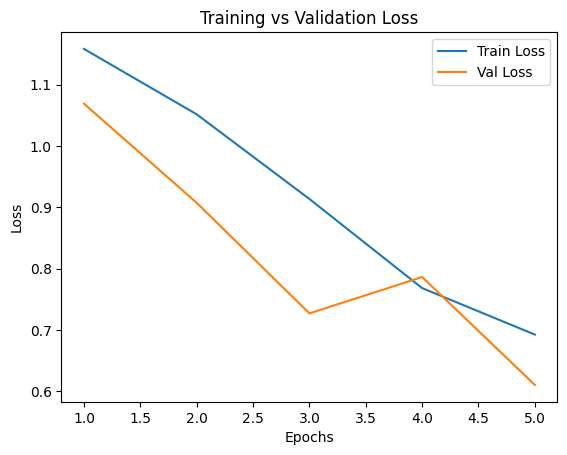

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

model = Model().to(device)

bce_loss = nn.BCEWithLogitsLoss()

def dice_loss(pred, target, smooth=1.0):
    pred = torch.sigmoid(pred)
    pred = pred.view(-1)
    target = target.view(-1)
    intersection = (pred * target).sum()
    return 1 - ((2. * intersection + smooth) / (pred.sum() + target.sum() + smooth))

def bce_dice_loss(pred, target):
    return bce_loss(pred, target) + dice_loss(pred, target)

optimizer = optim.Adam(model.parameters(), lr=1e-4)

num_epochs = 30
train_losses, val_losses = [], []

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    print(f"\nEpoch {epoch+1}/{num_epochs}")

    for batch_idx, (imgs, masks) in enumerate(train_loader, 1):
        imgs, masks = imgs.to(device), masks.to(device)

        optimizer.zero_grad()
        outputs = model(imgs)
        loss = bce_dice_loss(outputs, masks)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        if batch_idx % 10 == 0 or batch_idx == len(train_loader):
            print(f"  Batch [{batch_idx}/{len(train_loader)}] "
                  f"Loss: {loss.item():.4f}")

    epoch_train_loss = running_loss / len(train_loader)
    train_losses.append(epoch_train_loss)

    model.eval()
    val_running_loss = 0.0
    with torch.no_grad():
        for imgs, masks in val_loader:
            imgs, masks = imgs.to(device), masks.to(device)
            outputs = model(imgs)
            loss = bce_dice_loss(outputs, masks)
            val_running_loss += loss.item()

    epoch_val_loss = val_running_loss / len(val_loader)
    val_losses.append(epoch_val_loss)

    print(f"Epoch [{epoch+1}/{num_epochs}] "
          f"Train Loss: {epoch_train_loss:.4f} | "
          f"Val Loss: {epoch_val_loss:.4f}")

plt.plot(range(1, num_epochs+1), train_losses, label="Train Loss")
plt.plot(range(1, num_epochs+1), val_losses, label="Val Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.title("Training vs Validation Loss")
plt.show()


In [ ]:
torch.save({
    "epoch": num_epochs,
    "model_state_dict": model.state_dict(),
    "optimizer_state_dict": optimizer.state_dict(),
    "train_losses": train_losses,
    "val_losses": val_losses
}, "checkpoint.pth")


In [ ]:
checkpoint = torch.load("checkpoint.pth", map_location=device)

model.load_state_dict(checkpoint["model_state_dict"])
optimizer.load_state_dict(checkpoint["optimizer_state_dict"])

start_epoch = checkpoint["epoch"]
train_losses = checkpoint["train_losses"]
val_losses = checkpoint["val_losses"]

print(f"Resuming training from epoch {start_epoch}")


Resuming training from epoch 5


In [ ]:
extra_epochs = 10
for epoch in range(start_epoch, start_epoch + extra_epochs):
    model.train()
    running_loss = 0.0
    print(f"\nEpoch {epoch+1}")

    for batch_idx, (imgs, masks) in enumerate(train_loader, 1):
        imgs, masks = imgs.to(device), masks.to(device)

        optimizer.zero_grad()
        outputs = model(imgs)
        loss = bce_dice_loss(outputs, masks)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    epoch_train_loss = running_loss / len(train_loader)
    train_losses.append(epoch_train_loss)

    model.eval()
    val_running_loss = 0.0
    with torch.no_grad():
        for imgs, masks in val_loader:
            imgs, masks = imgs.to(device), masks.to(device)
            outputs = model(imgs)
            loss = bce_dice_loss(outputs, masks)
            val_running_loss += loss.item()

    epoch_val_loss = val_running_loss / len(val_loader)
    val_losses.append(epoch_val_loss)

    print(f"Epoch [{epoch+1}] "
          f"Train Loss: {epoch_train_loss:.4f} | "
          f"Val Loss: {epoch_val_loss:.4f}")


Epoch 6
Epoch [6] Train Loss: 0.6518 | Val Loss: 0.5720

Epoch 7
Epoch [7] Train Loss: 0.6351 | Val Loss: 0.5309

Epoch 8
Epoch [8] Train Loss: 0.6083 | Val Loss: 0.5291

Epoch 9
Epoch [9] Train Loss: 0.5978 | Val Loss: 0.5287

Epoch 10
Epoch [10] Train Loss: 0.5806 | Val Loss: 0.5260

Epoch 11
Epoch [11] Train Loss: 0.5737 | Val Loss: 0.5030

Epoch 12
Epoch [12] Train Loss: 0.5701 | Val Loss: 0.4949

Epoch 13
Epoch [13] Train Loss: 0.5604 | Val Loss: 0.5005

Epoch 14
Epoch [14] Train Loss: 0.5494 | Val Loss: 0.4799

Epoch 15
Epoch [15] Train Loss: 0.5431 | Val Loss: 0.4984


**3.3. Evaluate the Model**

In [ ]:
import torch
import numpy as np
from sklearn.metrics import precision_score, recall_score
import matplotlib.pyplot as plt

Average IoU: 0.3456
Average Dice: 0.4481
Average Precision: 0.4995
Average Recall: 0.3830


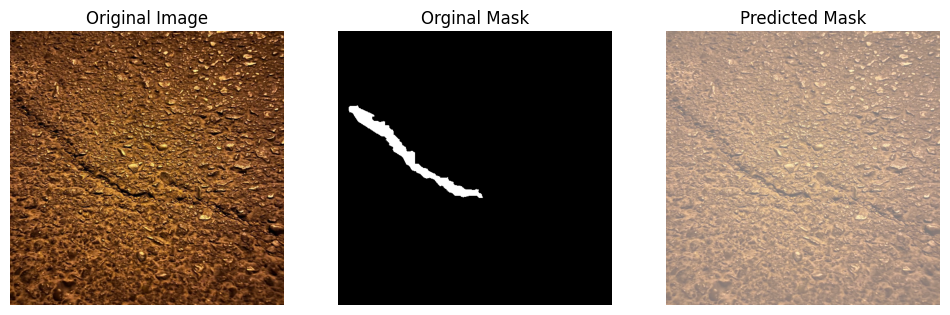

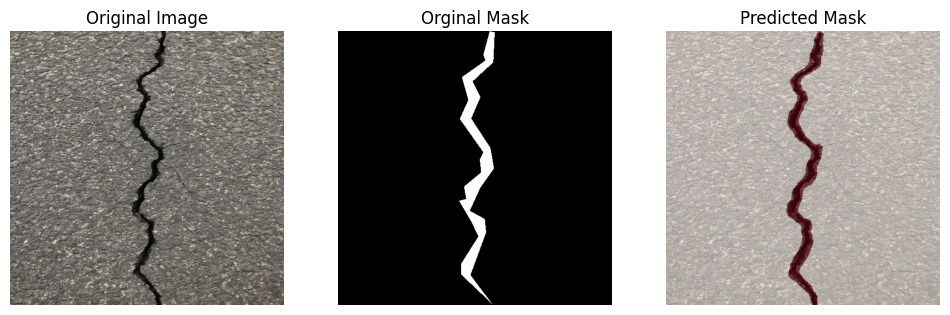

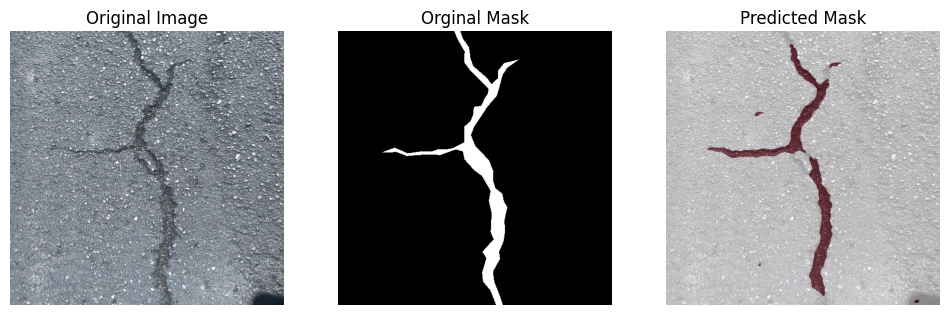

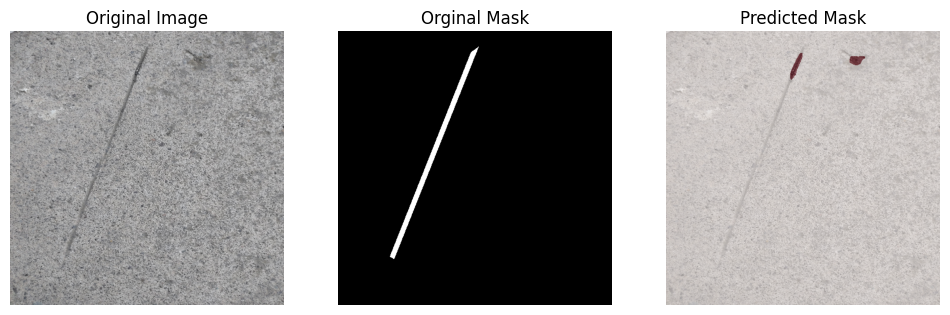

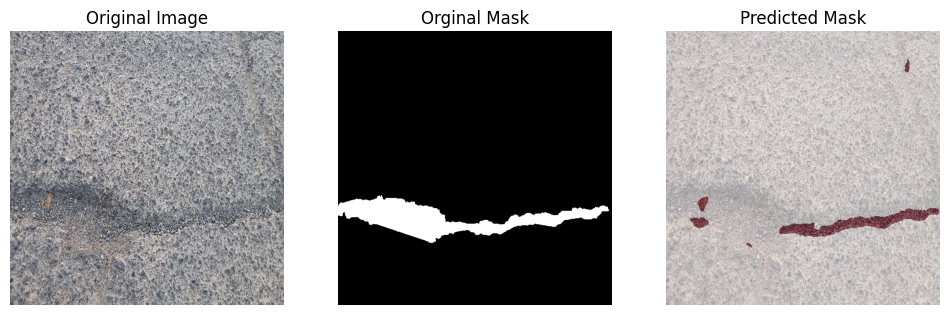

...

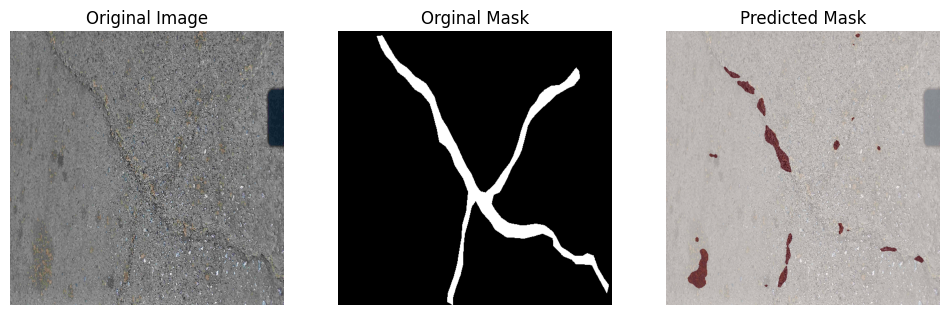

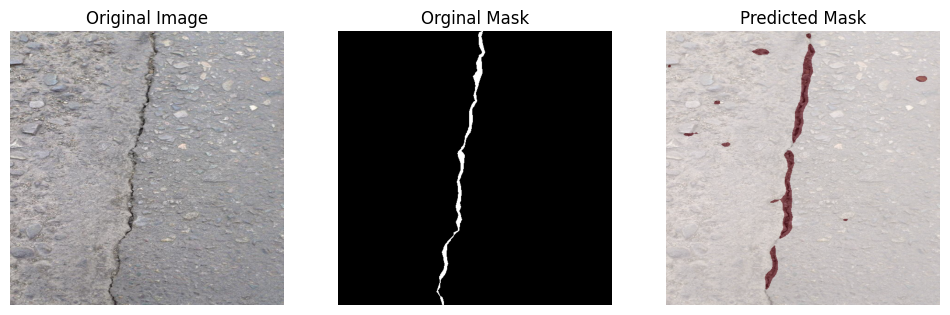

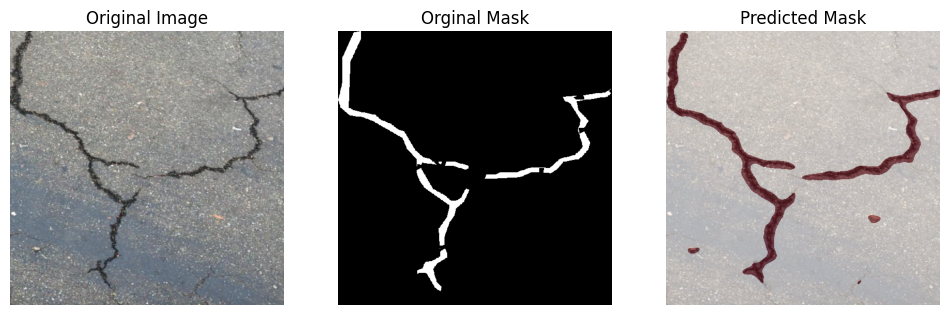

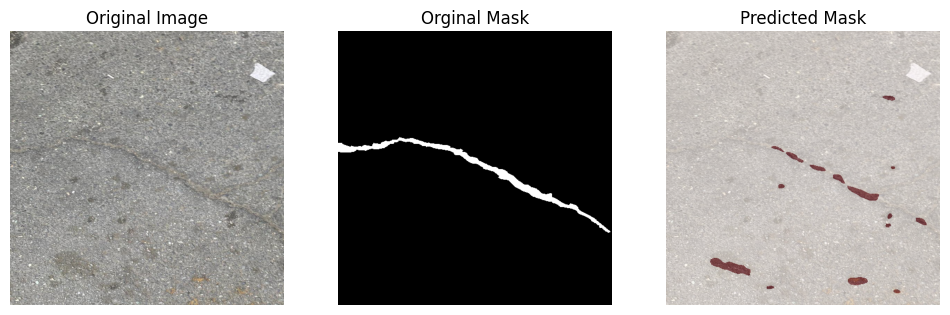

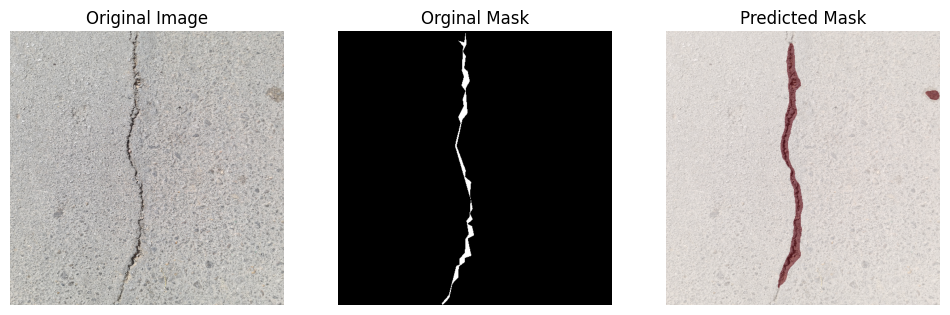

In [ ]:
def compute_metrics(pred_mask, true_mask, threshold=0.5, smooth=1e-6):
    pred_mask = torch.sigmoid(pred_mask)
    pred_bin = (pred_mask > threshold).float()
    true_mask = true_mask.float()

    intersection = (pred_bin * true_mask).sum()
    union = pred_bin.sum() + true_mask.sum() - intersection

    iou = (intersection + smooth) / (union + smooth)
    dice = (2 * intersection + smooth) / (pred_bin.sum() + true_mask.sum() + smooth)
    pred_flat = pred_bin.view(-1).cpu().numpy()
    true_flat = true_mask.view(-1).cpu().numpy()

    precision = precision_score(true_flat, pred_flat, zero_division=0)
    recall = recall_score(true_flat, pred_flat, zero_division=0)

    return iou.item(), dice.item(), precision, recall

ious, dices, precisions, recalls = [], [], [], []

model.eval()
with torch.no_grad():
    for imgs, masks in test_loader:
        imgs = imgs.to(device)
        masks = masks.to(device)
        outputs = model(imgs)
        for pred, true in zip(outputs, masks):
            iou, dice, precision, recall = compute_metrics(pred, true)
            ious.append(iou)
            dices.append(dice)
            precisions.append(precision)
            recalls.append(recall)


print(f"Average IoU: {np.mean(ious):.4f}")
print(f"Average Dice: {np.mean(dices):.4f}")
print(f"Average Precision: {np.mean(precisions):.4f}")
print(f"Average Recall: {np.mean(recalls):.4f}")

def visualize_results(img, true_mask, pred_mask, threshold=0.5):
    img = img.cpu().numpy().transpose(1,2,0)
    true_mask = true_mask.cpu().numpy()
    if true_mask.ndim == 3:
        true_mask = true_mask[0]
    pred_mask = torch.sigmoid(pred_mask).cpu().numpy()
    if pred_mask.ndim == 3:
        pred_mask = pred_mask[0]
    pred_mask_bin = (pred_mask > threshold).astype(np.uint8)

    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1)
    plt.title("Original Image")
    plt.imshow(img)
    plt.axis('off')

    plt.subplot(1,3,2)
    plt.title("Orginal Mask")
    plt.imshow(true_mask, cmap='gray')
    plt.axis('off')

    plt.subplot(1,3,3)
    plt.title("Predicted Mask")
    plt.imshow(img)
    plt.imshow(pred_mask_bin, alpha=0.5, cmap='Reds')
    plt.axis('off')
    plt.show()

with torch.no_grad():
    for i, (img, mask) in enumerate(test_loader):
        if i >= 5:
            break
        output = model(img.to(device))
        for j in range(img.size(0)):
            visualize_results(img[j], mask[j], output[j])



**4.1 Choosing Transformations**

In [ ]:
def rotation(image, mask, angle_range=(-30, 30)):
    angle = random.uniform(*angle_range)
    h, w = image.shape[:2]
    M = cv2.getRotationMatrix2D((w//2, h//2), angle, 1.0)
    rotated_img = cv2.warpAffine(image, M, (w, h), flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_REFLECT)
    rotated_mask = cv2.warpAffine(mask, M, (w, h), flags=cv2.INTER_NEAREST, borderMode=cv2.BORDER_REFLECT)
    return rotated_img, rotated_mask

def scaling(image, mask, scale_range=(0.8, 1.2)):
    scale = random.uniform(*scale_range)
    h, w = image.shape[:2]
    new_h, new_w = int(h*scale), int(w*scale)
    scaled_img = cv2.resize(image, (new_w, new_h), interpolation=cv2.INTER_LINEAR)
    scaled_mask = cv2.resize(mask, (new_w, new_h), interpolation=cv2.INTER_NEAREST)

    if scale < 1.0:
        top = (h - new_h)//2
        bottom = h - new_h - top
        left = (w - new_w)//2
        right = w - new_w - left
        scaled_img = cv2.copyMakeBorder(scaled_img, top, bottom, left, right, cv2.BORDER_REFLECT)
        scaled_mask = cv2.copyMakeBorder(scaled_mask, top, bottom, left, right, cv2.BORDER_REFLECT)
    else:
        start_y = (new_h - h)//2
        start_x = (new_w - w)//2
        scaled_img = scaled_img[start_y:start_y+h, start_x:start_x+w]
        scaled_mask = scaled_mask[start_y:start_y+h, start_x:start_x+w]

    return scaled_img, scaled_mask


def brightness(image, brightness_range=(-0.2, 0.2)):
    brightness_factor = random.uniform(*brightness_range)
    img = image.astype(np.float32)
    img = img + brightness_factor * 255
    img = np.clip(img, 0, 255)
    return img.astype(np.uint8)

def contrast(image, contrast_range=(-0.2, 0.2)):
    contrast_factor = random.uniform(*contrast_range)
    img = image.astype(np.float32)
    mean = np.mean(img)
    img = (img - mean) * (1 + contrast_factor) + mean
    img = np.clip(img, 0, 255)
    return img.astype(np.uint8)

def add_gaussian_noise(image, std=10):
    noise = np.random.normal(0, std, image.shape).astype(np.float32)
    noisy_img = image.astype(np.float32) + noise
    noisy_img = np.clip(noisy_img, 0, 255).astype(np.uint8)
    return noisy_img


**4.2. Applying Transformations**

In [ ]:
img, mask = train_dataset[100]
img = img.permute(1,2,0).numpy()
img = (img * 255).astype(np.uint8)
mask = mask.squeeze().numpy()
mask = (mask * 255).astype(np.uint8)


In [ ]:
rot_img, rot_mask = rotation(img, mask)
sc_img, sc_mask = scaling(img, mask)
b_img = brightness(img, brightness_range=(-0.2, 0.2))
c_img = contrast(img, contrast_range=(-0.2, 0.2))
noise_img = add_gaussian_noise(img)

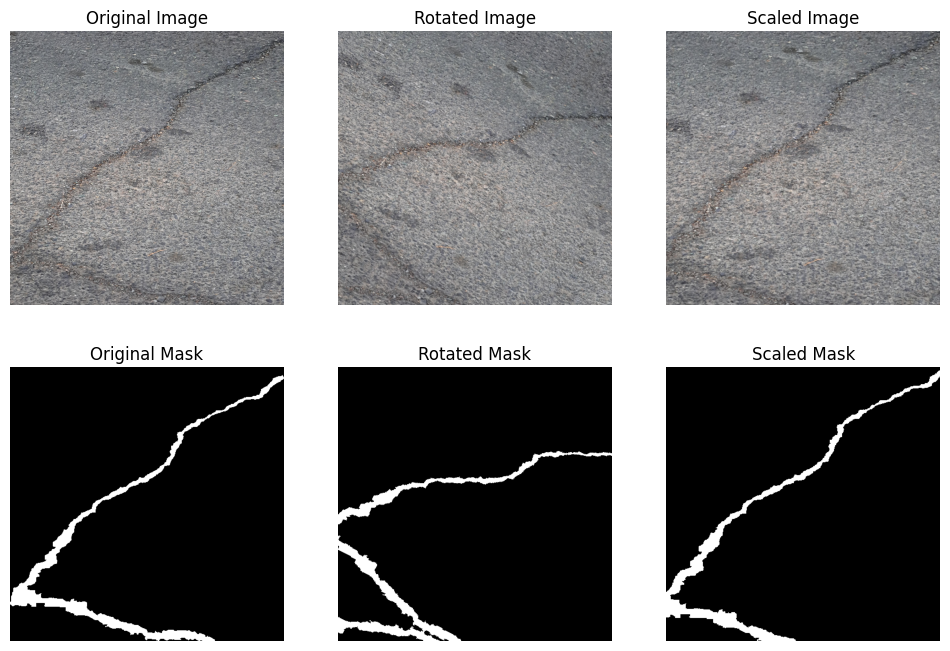

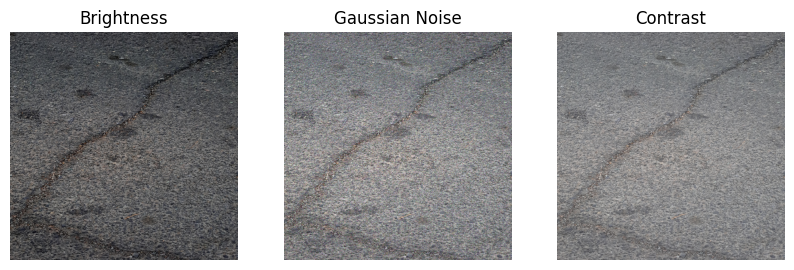

In [ ]:
plt.figure(figsize=(12,8))

plt.subplot(2,3,1); plt.imshow(img); plt.title("Original Image"); plt.axis("off")
plt.subplot(2,3,2); plt.imshow(rot_img); plt.title("Rotated Image"); plt.axis("off")
plt.subplot(2,3,3); plt.imshow(sc_img); plt.title("Scaled Image"); plt.axis("off")
plt.subplot(2,3,4); plt.imshow(mask, cmap="gray"); plt.title("Original Mask"); plt.axis("off")
plt.subplot(2,3,5); plt.imshow(rot_mask, cmap="gray"); plt.title("Rotated Mask"); plt.axis("off")
plt.subplot(2,3,6); plt.imshow(sc_mask, cmap="gray"); plt.title("Scaled Mask"); plt.axis("off")

plt.show()

plt.figure(figsize=(10,4))
plt.subplot(1,3,1); plt.imshow(b_img); plt.title("Brightness"); plt.axis("off")
plt.subplot(1,3,2); plt.imshow(noise_img); plt.title("Gaussian Noise"); plt.axis("off")
plt.subplot(1,3,3); plt.imshow(c_img); plt.title("Contrast"); plt.axis("off")

plt.show()


**4.3. Augmentation Pipeline**

In [ ]:
def augment(image, mask):
  rot_img, rot_mask = rotation(img, mask)
  sc_img, sc_mask = scaling(img, mask)
  b_img = brightness(img, brightness_range=(-0.2, 0.2))
  c_img = contrast(img, contrast_range=(-0.2, 0.2))
  noise_img = add_gaussian_noise(img)
  plt.figure(figsize=(12,8))

  plt.subplot(2,3,1); plt.imshow(img); plt.title("Original Image"); plt.axis("off")
  plt.subplot(2,3,2); plt.imshow(rot_img); plt.title("Rotated Image"); plt.axis("off")
  plt.subplot(2,3,3); plt.imshow(sc_img); plt.title("Scaled Image"); plt.axis("off")
  plt.subplot(2,3,4); plt.imshow(mask, cmap="gray"); plt.title("Original Mask"); plt.axis("off")
  plt.subplot(2,3,5); plt.imshow(rot_mask, cmap="gray"); plt.title("Rotated Mask"); plt.axis("off")
  plt.subplot(2,3,6); plt.imshow(sc_mask, cmap="gray"); plt.title("Scaled Mask"); plt.axis("off")

  plt.show()

  plt.figure(figsize=(10,4))
  plt.subplot(1,3,1); plt.imshow(b_img); plt.title("Brightness"); plt.axis("off")
  plt.subplot(1,3,2); plt.imshow(noise_img); plt.title("Gaussian Noise"); plt.axis("off")
  plt.subplot(1,3,3); plt.imshow(c_img); plt.title("Contrast"); plt.axis("off")

  plt.show()



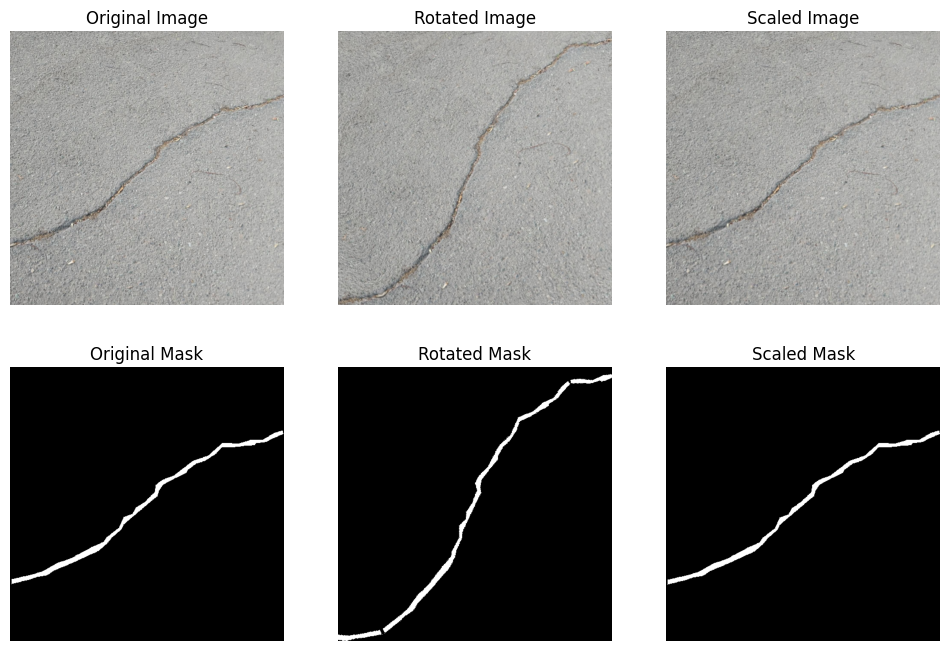

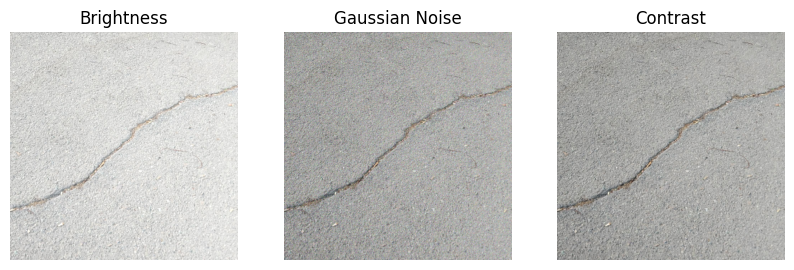

In [ ]:
img, mask = train_dataset[355]
img = img.permute(1,2,0).numpy()
img = (img * 255).astype(np.uint8)
mask = mask.squeeze().numpy()
mask = (mask * 255).astype(np.uint8)
augment(img, mask)

In [ ]:
def augment(image, mask):
    rot_img, rot_mask = rotation(image, mask)
    sc_img, sc_mask = scaling(image, mask)
    b_img = brightness(image, brightness_range=(-0.2, 0.2))
    c_img = contrast(image, contrast_range=(-0.2, 0.2))
    noise_img = add_gaussian_noise(image)

    return [
        (image, mask),
        (rot_img, rot_mask),
        (sc_img, sc_mask),
        (b_img, mask),
        (c_img, mask),
        (noise_img, mask)
    ]

augmented_dataset = []

for idx in range(len(train_dataset)):
    img, mask = train_dataset[idx]
    img = img.permute(1, 2, 0).numpy()
    img = (img * 255).astype(np.uint8)
    mask = mask.squeeze().numpy()
    mask = (mask * 255).astype(np.uint8)

    augmented_samples = augment(img, mask)

    augmented_dataset.extend(augmented_samples)

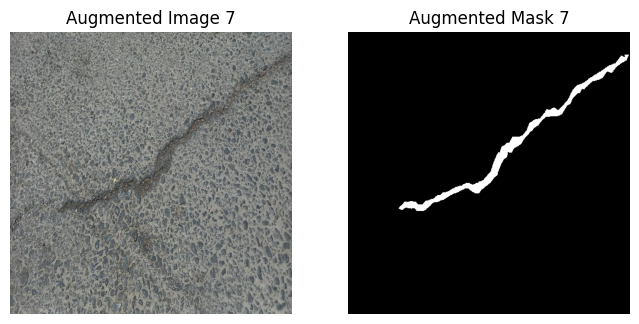

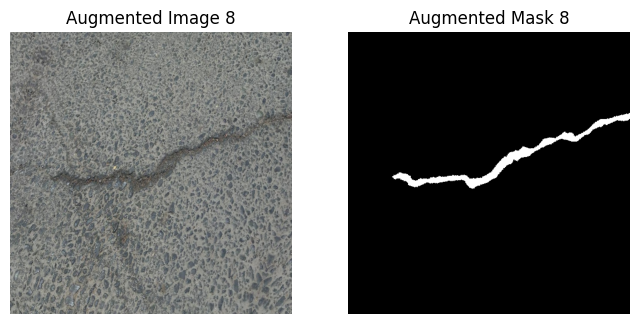

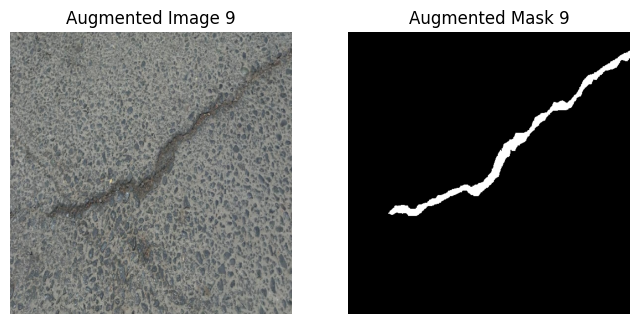

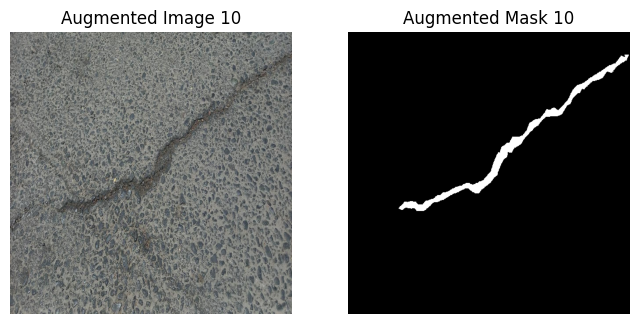

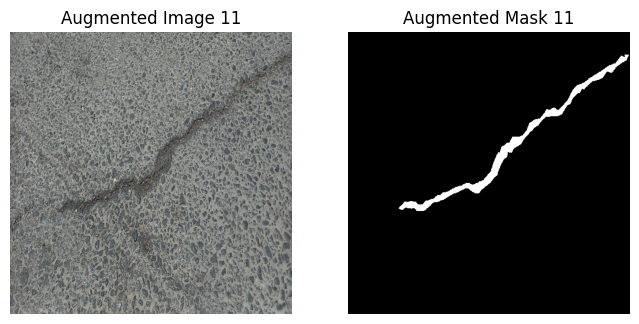

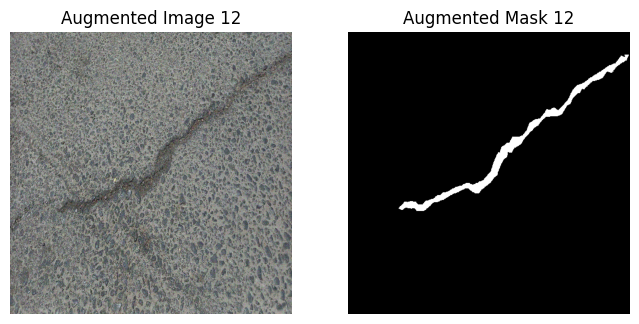

In [ ]:
def augment(image, mask):
    rot_img, rot_mask = rotation(image, mask)
    sc_img, sc_mask = scaling(image, mask)
    b_img = brightness(image, brightness_range=(-0.2, 0.2))
    c_img = contrast(image, contrast_range=(-0.2, 0.2))
    noise_img = add_gaussian_noise(image)

    return [
        (image, mask),
        (rot_img, rot_mask),
        (sc_img, sc_mask),
        (b_img, mask),
        (c_img, mask),
        (noise_img, mask)
    ]

augmented_dataset = []

for idx in range(len(train_dataset)):
    img, mask = train_dataset[idx]
    img = img.permute(1, 2, 0).numpy()
    img = (img * 255).astype(np.uint8)
    mask = mask.squeeze().numpy()
    mask = (mask * 255).astype(np.uint8)

    augmented_samples = augment(img, mask)

    augmented_dataset.extend(augmented_samples)

for i in range(6, min(12, len(augmented_dataset))):
    aug_img, aug_mask = augmented_dataset[i]
    plt.figure(figsize=(8, 4))
    plt.subplot(1, 2, 1); plt.imshow(aug_img); plt.title(f"Augmented Image {i+1}"); plt.axis("off")
    plt.subplot(1, 2, 2); plt.imshow(aug_mask, cmap="gray"); plt.title(f"Augmented Mask {i+1}"); plt.axis("off")
    plt.show()

In [ ]:
print(len(augmented_dataset))

8874


In [ ]:
class PreprocessedAugmentedDataset(Dataset):
    def __init__(self, augmented_data, img_size=(512, 512)):
        self.data = augmented_data
        self.img_size = img_size

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        image, mask = self.data[idx]

        h, w = self.img_size
        image_resized = cv2.resize(image, (w, h), interpolation=cv2.INTER_LINEAR)
        mask_resized = cv2.resize(mask, (w, h), interpolation=cv2.INTER_NEAREST)
        image_resized = image_resized.astype(np.float32) / 255.0
        image_resized = np.transpose(image_resized, (2, 0, 1))
        if mask_resized.ndim == 2:
            mask_resized = np.expand_dims(mask_resized, axis=0)
        mask_resized = mask_resized.astype(np.float32) / 255.0

        return torch.from_numpy(image_resized), torch.from_numpy(mask_resized)


In [ ]:
train_dataset_augmented = PreprocessedAugmentedDataset(augmented_dataset)
train_loader_augmented = DataLoader(train_dataset_augmented, batch_size=8, shuffle=True)

In [ ]:
import torch
import torchvision.transforms as T
import numpy as np
import cv2
import matplotlib.pyplot as plt

def preprocess_image(image_path, device, input_size=(512, 512)):

    orig_img = cv2.imread(image_path)
    orig_img = cv2.cvtColor(orig_img, cv2.COLOR_BGR2RGB)
    h, w = orig_img.shape[:2]

    transform = T.Compose([
        T.ToPILImage(),
        T.Resize(input_size),
        T.ToTensor()
    ])

    img_tensor = transform(orig_img).unsqueeze(0).to(device)
    return img_tensor, orig_img, (h, w)


def predict_mask(model, img_tensor, orig_size, threshold=0.5):
    model = Model()
    model.load_state_dict(torch.load('model_state_dict.pth'))
    model.eval()
    with torch.no_grad():
        output = model(img_tensor)
        output = torch.sigmoid(output)
        output = output.squeeze().cpu().numpy()

    mask = (output > threshold).astype(np.uint8)

    mask_resized = cv2.resize(mask, (orig_size[1], orig_size[0]), interpolation=cv2.INTER_NEAREST)
    return mask_resized



def visualize_pipeline(orig_img, mask):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.title("Original Image")
    plt.imshow(orig_img)
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.title("Predicted Mask")
    plt.imshow(mask, cmap="gray")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.title("Overlay")
    plt.imshow(orig_img)
    plt.imshow(mask, alpha=0.5, cmap="Reds")
    plt.axis("off")

    plt.show()

def run_inference(image_path, model, device, input_size=(512, 512), threshold=0.5):
    img_tensor, orig_img, orig_size = preprocess_image(image_path, device, input_size)
    pred_mask = predict_mask(model, img_tensor, orig_size, threshold)
    visualize_pipeline(orig_img, pred_mask)
    return pred_mask


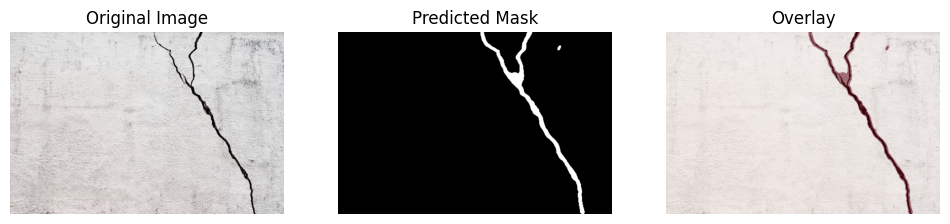

In [ ]:
mask = run_inference("sample_test_image.jpg", model, device, input_size=(512, 512), threshold=0.5)


**5. Regularize Your Model Using Dropout**

In [ ]:
class Model_Regularized(nn.Module):
    def __init__(self, in_channels=3, out_channels=1, dropout_p=0.3):
        super(Model_Regularized, self).__init__()

        self.enc1 = nn.Sequential(
            nn.Conv2d(in_channels, 32, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout_p),
            nn.Conv2d(32, 32, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout_p),
        )
        self.pool1 = nn.MaxPool2d(2)

        self.enc2 = nn.Sequential(
            nn.Conv2d(32, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout_p),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout_p),
        )
        self.pool2 = nn.MaxPool2d(2)

        self.enc3 = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout_p),
            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout_p),
        )
        self.pool3 = nn.MaxPool2d(2)

        self.bottleneck = nn.Sequential(
            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout_p),
            nn.Conv2d(256, 256, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout_p),
        )

        self.up3 = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
        self.dec3 = nn.Sequential(
            nn.Conv2d(256+128, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout_p),
            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout_p),
        )

        self.up2 = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
        self.dec2 = nn.Sequential(
            nn.Conv2d(128+64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout_p),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout_p),
        )

        self.up1 = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
        self.dec1 = nn.Sequential(
            nn.Conv2d(64+32, 32, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout_p),
            nn.Conv2d(32, 32, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout_p),
        )

        self.final_conv = nn.Conv2d(32, out_channels, kernel_size=1)

    def forward(self, x):
        e1 = self.enc1(x)
        p1 = self.pool1(e1)

        e2 = self.enc2(p1)
        p2 = self.pool2(e2)

        e3 = self.enc3(p2)
        p3 = self.pool3(e3)

        b = self.bottleneck(p3)

        d3 = self.up3(b)
        d3 = torch.cat([d3, e3], dim=1)
        d3 = self.dec3(d3)

        d2 = self.up2(d3)
        d2 = torch.cat([d2, e2], dim=1)
        d2 = self.dec2(d2)

        d1 = self.up1(d2)
        d1 = torch.cat([d1, e1], dim=1)
        d1 = self.dec1(d1)

        out = self.final_conv(d1)
        return out

In [ ]:
class Model_Reg(nn.Module):
    def __init__(self, in_channels=3, out_channels=1, p_enc3=0.3, p_bottleneck=0.5):
        super(Model_Reg, self).__init__()

        self.enc1 = nn.Sequential(
            nn.Conv2d(in_channels, 32, kernel_size=3, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.Conv2d(32, 32, kernel_size=3, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
        )
        self.pool1 = nn.MaxPool2d(2)

        self.enc2 = nn.Sequential(
            nn.Conv2d(32, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
        )
        self.pool2 = nn.MaxPool2d(2)

        self.enc3 = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.Dropout2d(p_enc3),
        )
        self.pool3 = nn.MaxPool2d(2)

        self.bottleneck = nn.Sequential(
            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Dropout2d(p_bottleneck),
            nn.Conv2d(256, 256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
        )

        self.up3 = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
        self.dec3 = nn.Sequential(
            nn.Conv2d(256+128, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
        )

        self.up2 = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
        self.dec2 = nn.Sequential(
            nn.Conv2d(128+64, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
        )

        self.up1 = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
        self.dec1 = nn.Sequential(
            nn.Conv2d(64+32, 32, kernel_size=3, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.Conv2d(32, 32, kernel_size=3, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
        )

        self.final_conv = nn.Conv2d(32, out_channels, kernel_size=1)

    def forward(self, x):
        e1 = self.enc1(x)
        p1 = self.pool1(e1)

        e2 = self.enc2(p1)
        p2 = self.pool2(e2)

        e3 = self.enc3(p2)
        p3 = self.pool3(e3)

        b = self.bottleneck(p3)

        d3 = self.up3(b)
        d3 = torch.cat([d3, e3], dim=1)
        d3 = self.dec3(d3)

        d2 = self.up2(d3)
        d2 = torch.cat([d2, e2], dim=1)
        d2 = self.dec2(d2)

        d1 = self.up1(d2)
        d1 = torch.cat([d1, e1], dim=1)
        d1 = self.dec1(d1)

        out = self.final_conv(d1)
        return out


if __name__ == "__main__":
    model = Model_Reg()
    x = torch.randn(1, 3, 512, 512)
    y = model(x)
    print("Input:", x.shape)
    print("Output:", y.shape)


Input: torch.Size([1, 3, 512, 512])
Output: torch.Size([1, 1, 512, 512])


Using device: cuda

Epoch 1/5
  Batch [10/1110] Loss: 1.6482
  Batch [20/1110] Loss: 1.6250
  Batch [30/1110] Loss: 1.5781
  Batch [40/1110] Loss: 1.4950
  Batch [50/1110] Loss: 1.4905
  Batch [60/1110] Loss: 1.4077
  Batch [70/1110] Loss: 1.4771
  Batch [80/1110] Loss: 1.4106
  Batch [90/1110] Loss: 1.3379
  Batch [100/1110] Loss: 1.3967
  Batch [110/1110] Loss: 1.3856
  Batch [120/1110] Loss: 1.4058
  Batch [130/1110] Loss: 1.3806
  Batch [140/1110] Loss: 1.3809
  Batch [150/1110] Loss: 1.3679
  Batch [160/1110] Loss: 1.2481
  Batch [170/1110] Loss: 1.3561
  Batch [180/1110] Loss: 1.3797
  Batch [190/1110] Loss: 1.3593
  Batch [200/1110] Loss: 1.3253
  Batch [210/1110] Loss: 1.3223
  Batch [220/1110] Loss: 1.2801
  Batch [230/1110] Loss: 1.3705
  Batch [240/1110] Loss: 1.2793
  Batch [250/1110] Loss: 1.3385
  Batch [260/1110] Loss: 1.2989
  Batch [270/1110] Loss: 1.2608
  Batch [280/1110] Loss: 1.2461
  Batch [290/1110] Loss: 1.2942
  Batch [300/1110] Loss: 1.2524
  Batch [310/1110] 

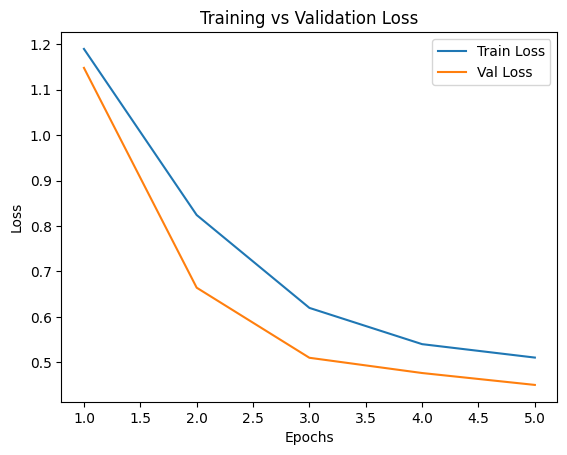

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

model_reg = Model_Reg().to(device)

bce_loss = nn.BCEWithLogitsLoss()

def dice_loss(pred, target, smooth=1.0):
    pred = torch.sigmoid(pred)
    pred = pred.view(-1)
    target = target.view(-1)
    intersection = (pred * target).sum()
    return 1 - ((2. * intersection + smooth) / (pred.sum() + target.sum() + smooth))

def bce_dice_loss(pred, target):
    return bce_loss(pred, target) + dice_loss(pred, target)

optimizer = optim.Adam(model_reg.parameters(), lr=1e-4)

num_epochs = 5
train_losses, val_losses = [], []

for epoch in range(num_epochs):
    model_reg.train()
    running_loss = 0.0
    print(f"\nEpoch {epoch+1}/{num_epochs}")

    for batch_idx, (imgs, masks) in enumerate(train_loader_augmented, 1):
        imgs, masks = imgs.to(device), masks.to(device)

        optimizer.zero_grad()
        outputs = model_reg(imgs)
        loss = bce_dice_loss(outputs, masks)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        if batch_idx % 10 == 0 or batch_idx == len(train_loader_augmented):
            print(f"  Batch [{batch_idx}/{len(train_loader_augmented)}] "
                  f"Loss: {loss.item():.4f}")

    epoch_train_loss = running_loss / len(train_loader_augmented)
    train_losses.append(epoch_train_loss)

    model_reg.eval()
    val_running_loss = 0.0
    with torch.no_grad():
        for imgs, masks in val_loader:
            imgs, masks = imgs.to(device), masks.to(device)
            outputs = model_reg(imgs)
            loss = bce_dice_loss(outputs, masks)
            val_running_loss += loss.item()

    epoch_val_loss = val_running_loss / len(val_loader)
    val_losses.append(epoch_val_loss)

    print(f"Epoch [{epoch+1}/{num_epochs}] "
          f"Train Loss: {epoch_train_loss:.4f} | "
          f"Val Loss: {epoch_val_loss:.4f}")

plt.plot(range(1, num_epochs+1), train_losses, label="Train Loss")
plt.plot(range(1, num_epochs+1), val_losses, label="Val Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.title("Training vs Validation Loss")
plt.show()


In [ ]:
torch.save(model.state_dict(), "modelreg_state_dict.pth")

In [ ]:
from google.colab import files
files.download('modelreg_state_dict.pth')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
def compute_metrics(pred_mask, true_mask, threshold=0.5, smooth=1e-6):
    pred_mask = torch.sigmoid(pred_mask)
    pred_bin = (pred_mask > threshold).float()
    true_mask = true_mask.float()

    intersection = (pred_bin * true_mask).sum()
    union = pred_bin.sum() + true_mask.sum() - intersection

    iou = (intersection + smooth) / (union + smooth)
    dice = (2 * intersection + smooth) / (pred_bin.sum() + true_mask.sum() + smooth)
    pred_flat = pred_bin.view(-1).cpu().numpy()
    true_flat = true_mask.view(-1).cpu().numpy()

    precision = precision_score(true_flat, pred_flat, zero_division=0)
    recall = recall_score(true_flat, pred_flat, zero_division=0)

    return iou.item(), dice.item(), precision, recall

ious, dices, precisions, recalls = [], [], [], []

model_reg.eval()
with torch.no_grad():
    for imgs, masks in test_loader:
        imgs = imgs.to(device)
        masks = masks.to(device)
        outputs = model_reg(imgs)
        for pred, true in zip(outputs, masks):
            iou, dice, precision, recall = compute_metrics(pred, true)
            ious.append(iou)
            dices.append(dice)
            precisions.append(precision)
            recalls.append(recall)


print(f"Average IoU: {np.mean(ious):.4f}")
print(f"Average Dice: {np.mean(dices):.4f}")
print(f"Average Precision: {np.mean(precisions):.4f}")
print(f"Average Recall: {np.mean(recalls):.4f}")

def visualize_results(img, true_mask, pred_mask, threshold=0.5):
    img = img.cpu().numpy().transpose(1,2,0)
    true_mask = true_mask.cpu().numpy()
    if true_mask.ndim == 3:
        true_mask = true_mask[0]
    pred_mask = torch.sigmoid(pred_mask).cpu().numpy()
    if pred_mask.ndim == 3:
        pred_mask = pred_mask[0]
    pred_mask_bin = (pred_mask > threshold).astype(np.uint8)

    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1)
    plt.title("Original Image")
    plt.imshow(img)
    plt.axis('off')

    plt.subplot(1,3,2)
    plt.title("Orginal Mask")
    plt.imshow(true_mask, cmap='gray')
    plt.axis('off')

    plt.subplot(1,3,3)
    plt.title("Predicted Mask")
    plt.imshow(img)
    plt.imshow(pred_mask_bin, alpha=0.5, cmap='Reds')
    plt.axis('off')
    plt.show()

with torch.no_grad():
    for i, (img, mask) in enumerate(test_loader):
        if i >= 5:
            break
        output = model_reg(img.to(device))
        for j in range(img.size(0)):
            visualize_results(img[j], mask[j], output[j])


Using device: cuda

Epoch 1/10
  Batch [10/370] Loss: 1.6041
  Batch [20/370] Loss: 1.6194
  Batch [30/370] Loss: 1.5828
  Batch [40/370] Loss: 1.3074
  Batch [50/370] Loss: 1.1425
  Batch [60/370] Loss: 1.1452
  Batch [70/370] Loss: 1.1686
  Batch [80/370] Loss: 1.8764
  Batch [90/370] Loss: 1.1754
  Batch [100/370] Loss: 1.0773
  Batch [110/370] Loss: 1.0861
  Batch [120/370] Loss: 1.0986
  Batch [130/370] Loss: 1.1459
  Batch [140/370] Loss: 1.0990
  Batch [150/370] Loss: 1.0915
  Batch [160/370] Loss: 1.1265
  Batch [170/370] Loss: 1.1408
  Batch [180/370] Loss: 1.1998
  Batch [190/370] Loss: 1.1378
  Batch [200/370] Loss: 1.1309
  Batch [210/370] Loss: 1.0586
  Batch [220/370] Loss: 1.1376
  Batch [230/370] Loss: 1.1042
  Batch [240/370] Loss: 1.1662
  Batch [250/370] Loss: 1.2335
  Batch [260/370] Loss: 1.1566
  Batch [270/370] Loss: 1.1627
  Batch [280/370] Loss: 1.1352
  Batch [290/370] Loss: 1.1376
  Batch [300/370] Loss: 1.0699
  Batch [310/370] Loss: 1.1278
  Batch [320/370]

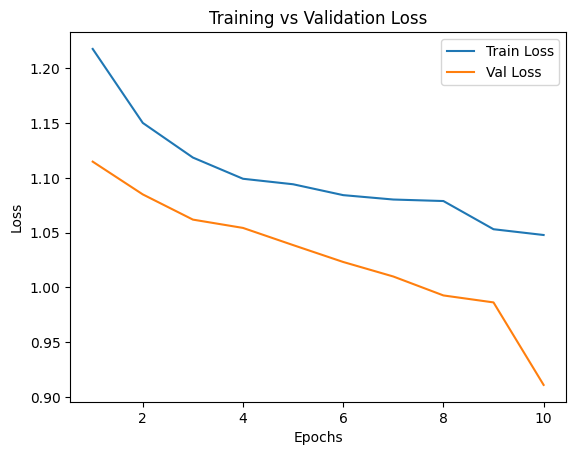

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

model_regularized = Model_Regularized().to(device)

bce_loss = nn.BCEWithLogitsLoss()

def dice_loss(pred, target, smooth=1.0):
    pred = torch.sigmoid(pred)
    pred = pred.view(-1)
    target = target.view(-1)
    intersection = (pred * target).sum()
    return 1 - ((2. * intersection + smooth) / (pred.sum() + target.sum() + smooth))

def bce_dice_loss(pred, target):
    return bce_loss(pred, target) + dice_loss(pred, target)

optimizer = optim.Adam(model_regularized.parameters(), lr=1e-4)

num_epochs = 5
train_losses, val_losses = [], []

for epoch in range(num_epochs):
    model_regularized.train()
    running_loss = 0.0
    print(f"\nEpoch {epoch+1}/{num_epochs}")

    for batch_idx, (imgs, masks) in enumerate(train_loader, 1):
        imgs, masks = imgs.to(device), masks.to(device)

        optimizer.zero_grad()
        outputs = model_regularized(imgs)
        loss = bce_dice_loss(outputs, masks)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        if batch_idx % 10 == 0 or batch_idx == len(train_loader):
            print(f"  Batch [{batch_idx}/{len(train_loader)}] "
                  f"Loss: {loss.item():.4f}")

    epoch_train_loss = running_loss / len(train_loader)
    train_losses.append(epoch_train_loss)

    model_regularized.eval()
    val_running_loss = 0.0
    with torch.no_grad():
        for imgs, masks in val_loader:
            imgs, masks = imgs.to(device), masks.to(device)
            outputs = model_regularized(imgs)
            loss = bce_dice_loss(outputs, masks)
            val_running_loss += loss.item()

    epoch_val_loss = val_running_loss / len(val_loader)
    val_losses.append(epoch_val_loss)

    print(f"Epoch [{epoch+1}/{num_epochs}] "
          f"Train Loss: {epoch_train_loss:.4f} | "
          f"Val Loss: {epoch_val_loss:.4f}")

plt.plot(range(1, num_epochs+1), train_losses, label="Train Loss")
plt.plot(range(1, num_epochs+1), val_losses, label="Val Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.title("Training vs Validation Loss")
plt.show()


Average IoU: 0.1829
Average Dice: 0.2463
Average Precision: 0.4007
Average Recall: 0.1544


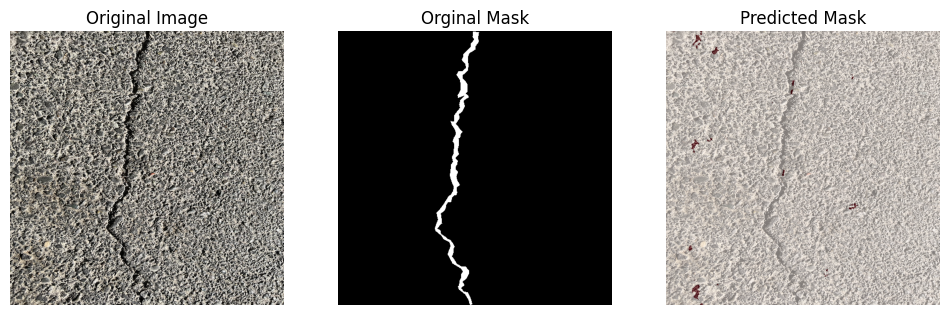

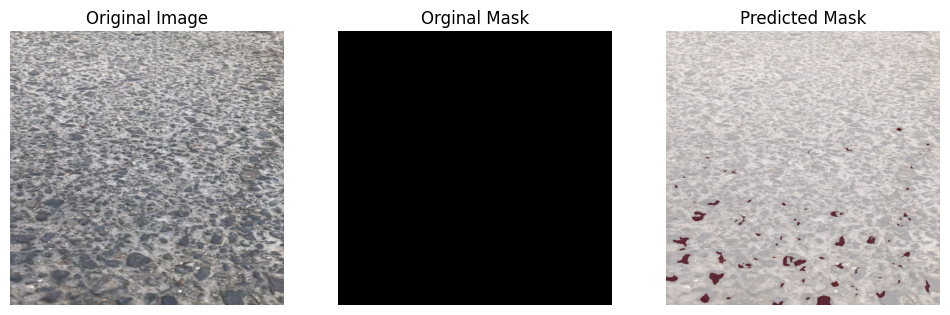

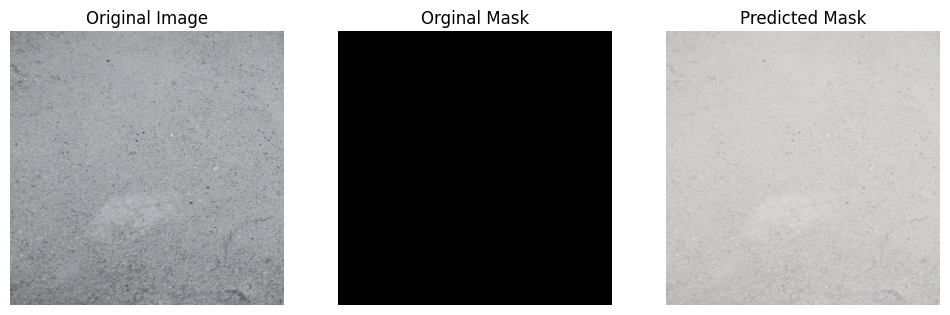

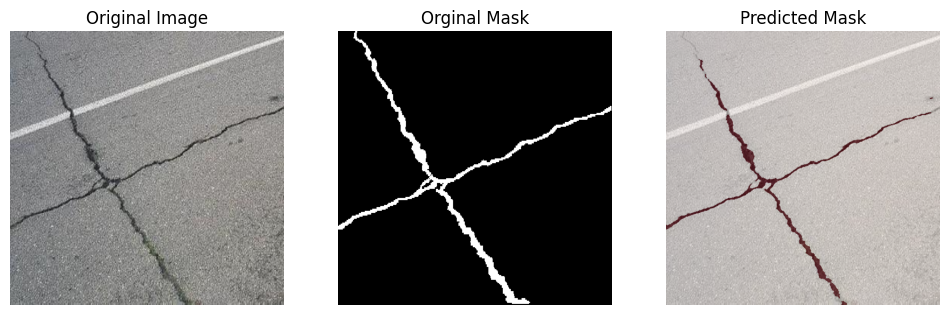

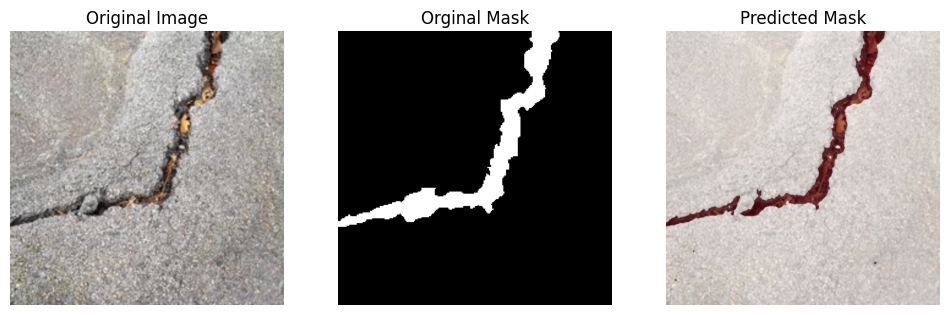

...

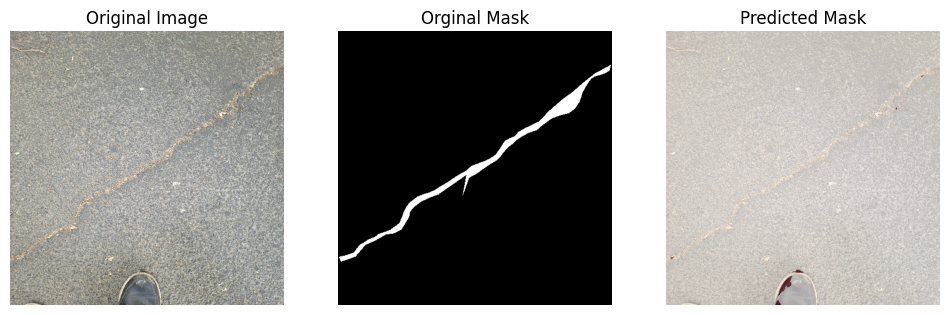

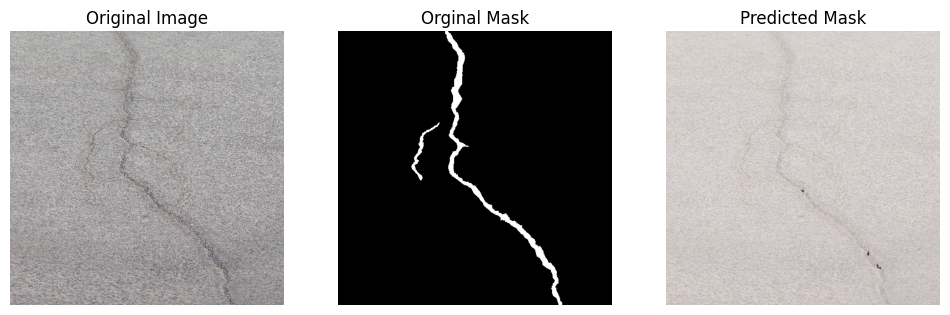

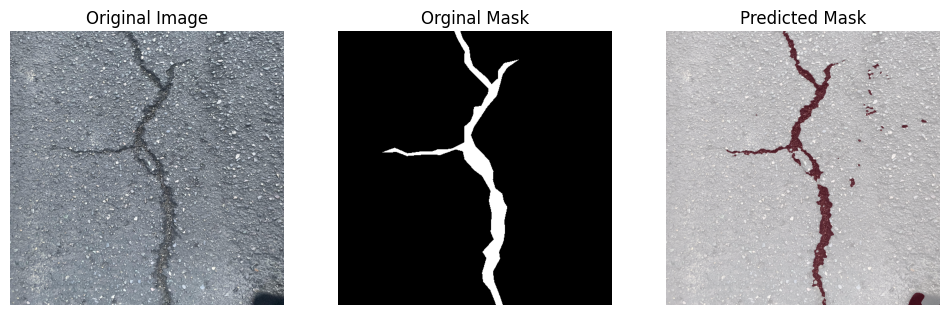

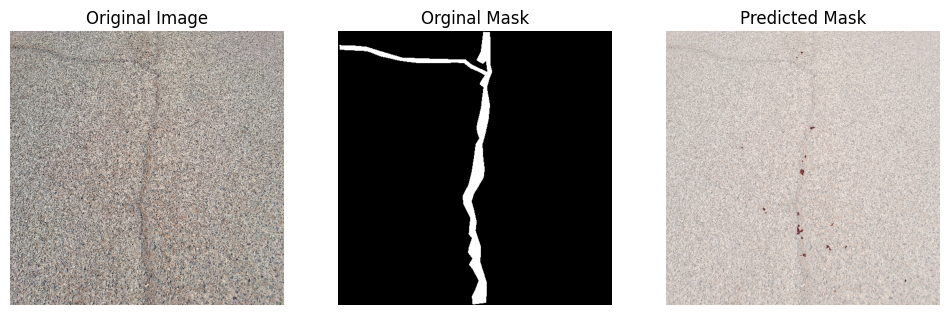

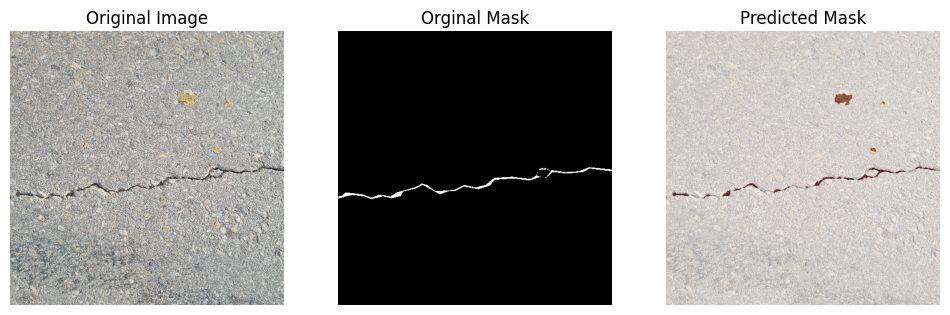

In [ ]:
def compute_metrics(pred_mask, true_mask, threshold=0.5, smooth=1e-6):
    pred_mask = torch.sigmoid(pred_mask)
    pred_bin = (pred_mask > threshold).float()
    true_mask = true_mask.float()

    intersection = (pred_bin * true_mask).sum()
    union = pred_bin.sum() + true_mask.sum() - intersection

    iou = (intersection + smooth) / (union + smooth)
    dice = (2 * intersection + smooth) / (pred_bin.sum() + true_mask.sum() + smooth)
    pred_flat = pred_bin.view(-1).cpu().numpy()
    true_flat = true_mask.view(-1).cpu().numpy()

    precision = precision_score(true_flat, pred_flat, zero_division=0)
    recall = recall_score(true_flat, pred_flat, zero_division=0)

    return iou.item(), dice.item(), precision, recall

ious, dices, precisions, recalls = [], [], [], []

model_regularized.eval()
with torch.no_grad():
    for imgs, masks in test_loader:
        imgs = imgs.to(device)
        masks = masks.to(device)
        outputs = model_regularized(imgs)
        for pred, true in zip(outputs, masks):
            iou, dice, precision, recall = compute_metrics(pred, true)
            ious.append(iou)
            dices.append(dice)
            precisions.append(precision)
            recalls.append(recall)


print(f"Average IoU: {np.mean(ious):.4f}")
print(f"Average Dice: {np.mean(dices):.4f}")
print(f"Average Precision: {np.mean(precisions):.4f}")
print(f"Average Recall: {np.mean(recalls):.4f}")

def visualize_results(img, true_mask, pred_mask, threshold=0.5):
    img = img.cpu().numpy().transpose(1,2,0)
    true_mask = true_mask.cpu().numpy()
    if true_mask.ndim == 3:
        true_mask = true_mask[0]
    pred_mask = torch.sigmoid(pred_mask).cpu().numpy()
    if pred_mask.ndim == 3:
        pred_mask = pred_mask[0]
    pred_mask_bin = (pred_mask > threshold).astype(np.uint8)

    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1)
    plt.title("Original Image")
    plt.imshow(img)
    plt.axis('off')

    plt.subplot(1,3,2)
    plt.title("Orginal Mask")
    plt.imshow(true_mask, cmap='gray')
    plt.axis('off')

    plt.subplot(1,3,3)
    plt.title("Predicted Mask")
    plt.imshow(img)
    plt.imshow(pred_mask_bin, alpha=0.5, cmap='Reds')
    plt.axis('off')
    plt.show()

with torch.no_grad():
    for i, (img, mask) in enumerate(test_loader):
        if i >= 5:
            break
        output = model_regularized(img.to(device))
        for j in range(img.size(0)):
            visualize_results(img[j], mask[j], output[j])


In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models

class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DoubleConv, self).__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
        )
    def forward(self, x):
        return self.net(x)

class Model_Reg_Transfer(nn.Module):
    def __init__(self, out_channels=1, p_enc3=0.3, p_bottleneck=0.5, freeze_encoder=True):
        super(Model_Reg_Transfer, self).__init__()

        base_model = models.resnet34(weights=models.ResNet34_Weights.IMAGENET1K_V1)
        enc_layers = list(base_model.children())

        self.layer0 = nn.Sequential(*enc_layers[:3])
        self.pool0 = enc_layers[3]
        self.layer1 = enc_layers[4]
        self.layer2 = enc_layers[5]
        self.layer3 = enc_layers[6]
        self.layer4 = enc_layers[7]

        if freeze_encoder:
            for param in base_model.parameters():
                param.requires_grad = False

        self.dropout_enc3 = nn.Dropout2d(p_enc3)
        self.dropout_bottleneck = nn.Dropout2d(p_bottleneck)

        self.up4 = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
        self.dec4 = DoubleConv(512 + 256, 256)

        self.up3 = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
        self.dec3 = DoubleConv(256 + 128, 128)

        self.up2 = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
        self.dec2 = DoubleConv(128 + 64, 64)

        self.up1 = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
        self.dec1 = DoubleConv(64 + 64, 32)

        self.final_conv = nn.Conv2d(32, out_channels, kernel_size=1)

    def forward(self, x):
        x0 = self.layer0(x)
        x0p = self.pool0(x0)
        x1 = self.layer1(x0p)
        x2 = self.layer2(x1)
        x3 = self.layer3(x2)
        x3 = self.dropout_enc3(x3)
        x4 = self.layer4(x3)
        x4 = self.dropout_bottleneck(x4)

        d4 = self.up4(x4)
        d4 = torch.cat([d4, x3], dim=1)
        d4 = self.dec4(d4)

        d3 = self.up3(d4)
        d3 = torch.cat([d3, x2], dim=1)
        d3 = self.dec3(d3)

        d2 = self.up2(d3)
        d2 = torch.cat([d2, x1], dim=1)
        d2 = self.dec2(d2)

        d1 = self.up1(d2)
        d1 = torch.cat([d1, x0], dim=1)
        d1 = self.dec1(d1)
        out = self.final_conv(d1)
        out = nn.functional.interpolate(out, size=x.shape[2:], mode='bilinear', align_corners=True)
        return torch.sigmoid(out)

if __name__ == "__main__":
    model = Model_Reg_Transfer(out_channels=1, freeze_encoder=True)
    x = torch.randn(1, 3, 512, 512)
    y = model(x)
    print("Input:", x.shape)
    print("Output:", y.shape)


Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth


100%|██████████| 83.3M/83.3M [00:00<00:00, 124MB/s]


Input: torch.Size([1, 3, 512, 512])
Output: torch.Size([1, 1, 512, 512])


In [ ]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from PIL import Image
import numpy as np
import albumentations as A
from albumentations.pytorch import ToTensorV2
from tqdm import tqdm

In [ ]:
# def dice_loss(pred, target, smooth=1e-6):
#     pred = pred.view(-1)
#     target = target.view(-1)
#     intersection = (pred * target).sum()
#     return 1 - (2*intersection + smooth)/(pred.sum() + target.sum() + smooth)

# def bce_dice_loss(pred, target):
#     bce = nn.BCELoss()(pred, target)
#     dice = dice_loss(pred, target)
#     return bce + dice

# def train_model(model, train_loader, val_loader, device, epochs=50, lr=1e-4,
#                 freeze_encoder_epochs=10, save_path="best_model.pth"):

#     optimizer = optim.Adam(model.parameters(), lr=lr)
#     best_val_dice = 0.0

#     for epoch in range(epochs):
#         if epoch == freeze_encoder_epochs:
#             print("Unfreezing encoder for fine-tuning...")
#             for param in model.parameters():
#                 param.requires_grad = True
#             optimizer = optim.Adam(model.parameters(), lr=lr/10)

#         model.train()
#         train_loss = 0.0
#         for imgs, masks in tqdm(train_loader, desc=f"Epoch {epoch+1} [Train]"):
#             imgs, masks = imgs.to(device), masks.to(device)

#             optimizer.zero_grad()
#             outputs = model(imgs)
#             loss = bce_dice_loss(outputs, masks)
#             loss.backward()
#             optimizer.step()
#             train_loss += loss.item() * imgs.size(0)
#         train_loss /= len(train_loader.dataset)

#         model.eval()
#         val_loss = 0.0
#         val_dice = 0.0
#         with torch.no_grad():
#             for imgs, masks in tqdm(val_loader, desc=f"Epoch {epoch+1} [Val]"):
#                 imgs, masks = imgs.to(device), masks.to(device)
#                 outputs = model(imgs)
#                 loss = bce_dice_loss(outputs, masks)
#                 val_loss += loss.item() * imgs.size(0)
#                 pred = (outputs > 0.5).float()
#                 intersection = (pred * masks).sum()
#                 val_dice += (2*intersection)/(pred.sum() + masks.sum() + 1e-6) * imgs.size(0)
#         val_loss /= len(val_loader.dataset)
#         val_dice /= len(val_loader.dataset)

#         print(f"Epoch [{epoch+1}/{epochs}] "
#               f"Train Loss: {train_loss:.4f}, "
#               f"Val Loss: {val_loss:.4f}, "
#               f"Val Dice: {val_dice:.4f}")

#         if val_dice > best_val_dice:
#             best_val_dice = val_dice
#             torch.save(model.state_dict(), save_path)
#             print(f"Saved Best Model with Dice: {best_val_dice:.4f}")
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# model_reg_transfer = Model_Reg_Transfer(out_channels=1, freeze_encoder=True).to(device)
# train_model(model_reg_transfer, train_loader_augmented, val_loader, device,
#                 epochs=5, lr=1e-4, freeze_encoder_epochs=3, save_path="best_model.pth")


In [ ]:
def compute_metrics(pred_mask, true_mask, threshold=0.5, smooth=1e-6):
    pred_mask = torch.sigmoid(pred_mask)
    pred_bin = (pred_mask > threshold).float()
    true_mask = true_mask.float()

    intersection = (pred_bin * true_mask).sum()
    union = pred_bin.sum() + true_mask.sum() - intersection

    iou = (intersection + smooth) / (union + smooth)
    dice = (2 * intersection + smooth) / (pred_bin.sum() + true_mask.sum() + smooth)
    pred_flat = pred_bin.view(-1).cpu().numpy()
    true_flat = true_mask.view(-1).cpu().numpy()

    precision = precision_score(true_flat, pred_flat, zero_division=0)
    recall = recall_score(true_flat, pred_flat, zero_division=0)

    return iou.item(), dice.item(), precision, recall

ious, dices, precisions, recalls = [], [], [], []

model_reg_transfer.eval()
with torch.no_grad():
    for imgs, masks in test_loader:
        imgs = imgs.to(device)
        masks = masks.to(device)
        outputs = model_reg_transfer(imgs)
        for pred, true in zip(outputs, masks):
            iou, dice, precision, recall = compute_metrics(pred, true)
            ious.append(iou)
            dices.append(dice)
            precisions.append(precision)
            recalls.append(recall)


print(f"Average IoU: {np.mean(ious):.4f}")
print(f"Average Dice: {np.mean(dices):.4f}")
print(f"Average Precision: {np.mean(precisions):.4f}")
print(f"Average Recall: {np.mean(recalls):.4f}")

def visualize_results(img, true_mask, pred_mask, threshold=0.5):
    img = img.cpu().numpy().transpose(1,2,0)
    true_mask = true_mask.cpu().numpy()
    if true_mask.ndim == 3:
        true_mask = true_mask[0]
    pred_mask = torch.sigmoid(pred_mask).cpu().numpy()
    if pred_mask.ndim == 3:
        pred_mask = pred_mask[0]
    pred_mask_bin = (pred_mask > threshold).astype(np.uint8)

    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1)
    plt.title("Original Image")
    plt.imshow(img)
    plt.axis('off')

    plt.subplot(1,3,2)
    plt.title("Orginal Mask")
    plt.imshow(true_mask, cmap='gray')
    plt.axis('off')

    plt.subplot(1,3,3)
    plt.title("Predicted Mask")
    plt.imshow(img)
    plt.imshow(pred_mask_bin, alpha=0.5, cmap='Reds')
    plt.axis('off')
    plt.show()

with torch.no_grad():
    for i, (img, mask) in enumerate(test_loader):
        if i >= 5:
            break
        output = model_reg_transfer(img.to(device))
        for j in range(img.size(0)):
            visualize_results(img[j], mask[j], output[j])
